# GG4257 - Urban Analytics: A Toolkit for Sustainable Urban Development
## Lab Workbook No 3: Geovisualization Techniques - Data Viz.
---
Dr Fernando Benitez -  University of St Andrews - School of Geography and Sustainable Development - Iteration 2025

# Objectives

By the end of this practical lab, you will be able to:

* Create summary descriptive statistics for numeric attributes
* Generate frequency tables
* Use aggregation functions
* Write a basic user function
* Convert between co-ordinate reference systems
* Create contextual statistics for geographic features using buffers
* Handle and Map big data sets using additional libraries and frameworks



> **GOOD ACADEMIC PRACTICE**: As always, The University policy on Good Academic Practice applies. There are probably many ways to address the challenges in here or part of them. You are free to do research and find relevant resources, like the documentation website, if you cited them correctly. But I strongly advise not to use AI tools, most importantly because you won't learn/practice as you are supposed to.
>
> If you still insist on using AI tools, you must cite any code or work you are taking/adapting from it. However, if cited correctly, your mark will be lower, and if not cited correctly, you risk incurring academic misconduct.
>
>  If you are not aware of **our academic misconduct policy**, kindly take a quick look (Pag 8. https://www.st-ndrews.ac.uk/policy/academic-policies-assessment-examination-and-award-good-academic-practice/good-academic-practice-guidance-for-students-frequently-asked-questions.pdf)


# Basic numeric summary statistics

In the first part of this practical, we will import some [Airbnb](http://insideairbnb.com/get-the-data.html) data for Amsterdam that was collected during July 2016. Adapted from (Singleton, 2017)
 

In [1]:
cd ..

/Users/milliemccallum/Documents/UrbanAnalytics


In [2]:
import pandas as pd

listings =pd.read_csv("Data/Data_lab3/data-2/listings.csv")


#Show column headings
listings.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,9784567,https://www.airbnb.com/rooms/9784567,20160704013910,2016-07-04,nice Room in Amsterdam,nice Room 20 Min.to Amst.center 10 minutes wal...,NaN,nice Room 20 Min.to Amst.center 10 minutes wal...,none,nice Park metro in front bus in front,...,8.0,f,NaN,Amsterdam,f,flexible,f,f,3,0.81
1,13163805,https://www.airbnb.com/rooms/13163805,20160704013910,2016-07-04,Best cost benefit room near a metro station,We (me and my wife) are constantly improving o...,NaN,We (me and my wife) are constantly improving o...,none,NaN,...,9.0,f,NaN,Amsterdam,t,flexible,f,f,1,4.00
2,3719167,https://www.airbnb.com/rooms/3719167,20160704013910,2016-07-04,Nice room in A´dam SE near nature & heart centre,I offer a beautiful 19 sqm room in a house on ...,"The location is close to the shops, public tra...",I offer a beautiful 19 sqm room in a house on ...,none,A lot of different internationalities and cult...,...,9.0,f,NaN,Amsterdam,f,moderate,f,f,1,0.48
3,13188367,https://www.airbnb.com/rooms/13188367,20160704013910,2016-07-04,Private room 15min metro ride from city center,The apartment is located a 15min ride from the...,NaN,The apartment is located a 15min ride from the...,none,NaN,...,10.0,f,NaN,NaN,f,moderate,f,f,1,1.62
4,4831606,https://www.airbnb.com/rooms/4831606,20160704013910,2016-07-04,Room in Amsterdam in a new house!! Free Bicycle,In Amsterdam Zuidoost (20 minutes to central s...,Smart tv,In Amsterdam Zuidoost (20 minutes to central s...,none,NaN,...,9.0,f,NaN,Amsterdam,f,moderate,f,f,1,0.65


However, for this practical, we will subset these data to a limited set of variables; in the previous example, we used a list or Dict to define a new subset of columns; here, you have another method.

In [28]:
# Subset data
subset_listings = listings[['id', 
                            'neighbourhood_cleansed',
                            'latitude',
                            'longitude',
                            'property_type',
                            'room_type',
                            'bedrooms',
                            'price',
                            'number_of_reviews']]

# We need to do some cleaning...There are some weird characters $ and , then convert the outcome to a dtype numeric.
# I use multiple functions in one line, but the key is using .loc and replace., check this link for more information.
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.loc.html
subset_listings.loc[subset_listings.index, 'price'] = subset_listings['price'].replace('[\$,]', '', regex=True).astype(float)

# Remove any records that are not complete
subset_listings = subset_listings.dropna()

# Let's see the results.
subset_listings.head()

,id,neighbourhood_cleansed,latitude,longitude,property_type,room_type,bedrooms,price,number_of_reviews
0,9784567,Bijlmer-Oost,52.323369,4.977730,Apartment,Private room,1.0,95.0,5
1,13163805,Bijlmer-Oost,52.315635,4.978166,Apartment,Private room,1.0,60.0,4
2,3719167,Bijlmer-Oost,52.316711,4.986618,House,Private room,1.0,45.0,11
3,13188367,Bijlmer-Oost,52.321204,4.976630,Apartment,Private room,1.0,35.0,2
4,4831606,Bijlmer-Oost,52.327270,4.967352,House,Private room,1.0,39.0,12


In [31]:
subset_listings.dtypes
subset_listings.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13837 entries, 0 to 13848
Data columns (total 9 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      13837 non-null  int64  
 1   neighbourhood_cleansed  13837 non-null  object 
 2   latitude                13837 non-null  float64
 3   longitude               13837 non-null  float64
 4   property_type           13837 non-null  object 
 5   room_type               13837 non-null  object 
 6   bedrooms                13837 non-null  float64
 7   price                   13837 non-null  object 
 8   number_of_reviews       13837 non-null  int64  
dtypes: float64(3), int64(2), object(4)
memory usage: 1.1+ MB


The simplest way to create a set of descriptive statistics is to use the **describe()** function which returns the minimum, maximum, first and third quartile, and the mean and median for each column. For non numeric columns (e.g. neighbourhood_cleansed),the frequencies of the top seven most frequent attributes are shown.

In [5]:
# Generate descriptive statistics
descriptive_stats = subset_listings.describe()
descriptive_stats

,id,latitude,longitude,bedrooms,number_of_reviews
count,1.383700e+04,13837.000000,13837.000000,13837.000000,13837.000000
mean,7.418371e+06,52.365572,4.889060,1.428344,15.416926
std,4.225013e+06,0.015318,0.034319,0.888810,29.831525
min,2.818000e+03,52.290402,4.763264,0.000000,0.000000
25%,3.736210e+06,52.355850,4.865530,1.000000,1.000000
50%,7.555967e+06,52.365217,4.886416,1.000000,6.000000
75%,1.126715e+07,52.374953,4.907381,2.000000,16.000000
max,1.382844e+07,52.428571,5.027689,10.000000,416.000000


In [6]:
descriptive_stats_non_numerical = subset_listings.describe(exclude='number')
descriptive_stats_non_numerical

,neighbourhood_cleansed,property_type,room_type,price
count,13837,13837,13837,13837.0
unique,22,18,3,329.0
top,De Baarsjes - Oud-West,Apartment,Entire home/apt,120.0
freq,2430,10954,11157,844.0


# Frequency tables

Another common fundamental analysis task is to create a frequency table for a categorical variable - for example, the number of listings per neighbourhood. This can be achieved using the value_counts() function, which prints a list of the unique attributes and the frequency of these observations.


In [7]:
neighborhood_counts = subset_listings['neighbourhood_cleansed'].value_counts()
neighborhood_counts

neighbourhood_cleansed
De Baarsjes - Oud-West                    2430
Centrum-West                              1878
De Pijp - Rivierenbuurt                   1619
Centrum-Oost                              1345
Westerpark                                1029
Zuid                                      1008
Oud-Oost                                   806
Bos en Lommer                              695
Oostelijk Havengebied - Indische Buurt     694
Oud-Noord                                  390
Watergraafsmeer                            362
Slotervaart                                280
IJburg - Zeeburgereiland                   272
Noord-West                                 186
Buitenveldert - Zuidas                     160
Noord-Oost                                 159
Geuzenveld - Slotermeer                    138
Osdorp                                      99
De Aker - Nieuw Sloten                      91
Bijlmer-Oost                                72
Gaasperdam - Driemond                

It is also possible to create cross-tabulations; showing the frequency of two attributes - here we look at neighborhood and bedrooms:

In [8]:
# Here for the complete doc https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.crosstab.html 
cross_tabulation = pd.crosstab(subset_listings['neighbourhood_cleansed'], subset_listings['bedrooms'])
cross_tabulation

bedrooms,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0
neighbourhood_cleansed,,,,,,,,,,,
Bijlmer-Centrum,5,54,0,2,0,0,0,0,0,0,0
Bijlmer-Oost,3,49,17,3,0,0,0,0,0,0,0
Bos en Lommer,49,453,154,35,4,0,0,0,0,0,0
Buitenveldert - Zuidas,4,94,40,14,7,1,0,0,0,0,0
Centrum-Oost,88,792,333,95,29,6,1,0,0,0,1
Centrum-West,164,1167,420,86,32,7,2,0,0,0,0
De Aker - Nieuw Sloten,6,48,21,12,4,0,0,0,0,0,0
De Baarsjes - Oud-West,80,1607,559,139,36,7,2,0,0,0,0
De Pijp - Rivierenbuurt,81,993,409,112,21,3,0,0,0,0,0


In [9]:
cross_tabulation.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22 entries, Bijlmer-Centrum to Zuid
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   0.0     22 non-null     int64
 1   1.0     22 non-null     int64
 2   2.0     22 non-null     int64
 3   3.0     22 non-null     int64
 4   4.0     22 non-null     int64
 5   5.0     22 non-null     int64
 6   6.0     22 non-null     int64
 7   7.0     22 non-null     int64
 8   8.0     22 non-null     int64
 9   9.0     22 non-null     int64
 10  10.0    22 non-null     int64
dtypes: int64(11)
memory usage: 2.1+ KB


# Create aggregations and summary statistics

I have shown how you can use various descriptive summary functions for single columns, however, it is also possible to combine these with other functions which make these calculations within aggregations. This is especially useful for geographic application where you can create summaries by a defined area. In the following example I will use the function groupby() to find out what the mean price is by neighborhood:


In [11]:
Sum_by_area = subset_listings.groupby('neighbourhood_cleansed')['price'].mean().reset_index()
Sum_by_area

,neighbourhood_cleansed,price
0,Bijlmer-Centrum,56.57377
1,Bijlmer-Oost,72.652778
2,Bos en Lommer,99.666187
3,Buitenveldert - Zuidas,118.14375
4,Centrum-Oost,160.517472
5,Centrum-West,168.887646
6,De Aker - Nieuw Sloten,119.824176
7,De Baarsjes - Oud-West,124.60823
8,De Pijp - Rivierenbuurt,131.371217
9,Gaasperdam - Driemond,79.253968


>The `reset_index()` function in pandas is used to reset the index of a DataFrame. In Pandas when you apply the `group_by()` the resulting DataFrame often has a hierarchical index based on the grouping columns, making it a MultiIndex DataFrame., usually that is an issue.

In our analysis, we have so far only examined the average price. However, if we want to generate several different statistics for each aggregation, we can do so by creating a custom function. Throughout the labs, we have used various functions, some of which are built into the base version of Python, while others are available through libraries that we have loaded.

In this example, we create a new function called `data_description`, which calculates a mean and counts the number of records - these are stored within a new object called "stats", which is returned when the function is run.

In [38]:
# data_description function
def data_description(x):
    
    stats = {'M': x.mean(), 'S': len(x)}
    return stats


In [41]:
result = data_description(subset_listings.price)
print(result)

{'M': 132.83038230830383, 'S': 13837}


# Challenge 1

**What happens if you have non-numerical attributes?**

Please extend the `data_description` function to only accept numerical columns and calculate mean and counts. The outcome should be a table with Mean and Counts per Column.

> Tip: Check this function in pandas to filter the numerical values. https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.select_dtypes.html#pandas.DataFrame.select_dtypes
> Here some extra resources of creating function in python https://www.geeksforgeeks.org/python-functions/?ref=lbp


In [14]:
def data_description (x): 
    
    stats = x.select_dtypes(include='number')

    stats_dict = {'M': stats.mean(), 'S': len(stats)}
    
    stats_pd = pd.DataFrame(stats_dict)
    

    stats_pd.columns = ['Mean', 'Count']
    
    return stats_pd

result = data_description(subset_listings)
result.head()

,Mean,Count
id,7.418371e+06,13837
latitude,5.236557e+01,13837
longitude,4.889060e+00,13837
bedrooms,1.428344e+00,13837
number_of_reviews,1.541693e+01,13837


# Spatial summary measures

So far we have considered a pre-defined geography in the previous example: neighborhoods. However, a common spatial analysis task is to create descriptive statistics related to the context of features. This task will typically require a buffer to be created around a feature and then data aggregated and summarized within the buffers.

First we will import a spatial data file that relates to [historic building locations](http://maps.amsterdam.nl/open_geodata/):


In [3]:
import geopandas as gpd

# Recall here how to read external files in geopandas. https://geopandas.org/en/stable/docs/user_guide/io.html
historic_buildings = gpd.read_file("Data/Data_lab3/data-2/historic_buildings.geojson", driver="GeoJSON")

historic_buildings.head()

,Naam,Hoofdgroep,Functie,Foto,Website,Opmerking,Begin,Eind,geometry
0,Atheneum Illustre 1632,Openbaar,,Atheneum Illustre.jpg,,Bron: Gerrit de Broen 1774-1782,1632,0,POINT (4.89500 52.36993)
1,Oude Kerk 1306,Religie,Kerk,Oude kerk.jpg,,Bron: Cornelis Anthonisz 1544,1306,0,POINT (4.89799 52.37431)
2,Windmolenzijdepoorthuis 1300-1380,Militair,Poort,,,,1300,1380,POINT (4.89673 52.37705)
3,Haarlemmerpoort 1425-1579,Militair,Poort,Haarlemmerpoort.jpg,,Bron: Cornelis Anthonisz 1544,1425,1579,POINT (4.89469 52.37891)
4,Bindwijkerpoort 1340-1425,Militair,Poort,,,,1340,1425,POINT (4.89102 52.36897)


Here is why I love python and GeoPandas, as the external file is GeoJSON including the geometry attribute, the result is already a spatial dataframe. That will be different in R where you need to locate the rows. 

In [ ]:
historic_buildings.explore()

In [ ]:
# We need to create a GeoDataFrame from the subset_listings
geometry = gpd.points_from_xy(subset_listings['longitude'], subset_listings['latitude'])
geo_listings = gpd.GeoDataFrame(subset_listings, geometry=geometry, crs=historic_buildings.crs)
geo_listings.explore()

In [5]:
print(historic_buildings.crs)
print(geo_listings.crs)

EPSG:4326
EPSG:4326


Before making any spatial analysis we need to project the data

In [6]:
projected_historic_buildings = historic_buildings.to_crs('EPSG:28992')
projected_geo_listings = geo_listings.to_crs('EPSG:28992')
print(projected_historic_buildings.crs)
print(projected_geo_listings.crs)

EPSG:28992
EPSG:28992


Now, lets make a buffer of 200m from all the historic buildings.

In [ ]:
historic_buffers = projected_historic_buildings.buffer(200)

historic_buffers.explore()

This outcome does not have an ID, so we can easily create one. Also, the outcome is a GeoSeries which cannot be used in a buffer analysis. You can transform it using the geometry values.

In [19]:
historic_buffers.crs = projected_historic_buildings.crs

In [20]:
historic_buffers = gpd.GeoDataFrame(geometry=historic_buffers)  
historic_buffers['buffer_id'] = range(len(historic_buffers))
historic_buffers.head()


,geometry,buffer_id
0,"POLYGON ((121678.929 487007.939, 121677.966 48...",0
1,"POLYGON ((121885.376 487494.564, 121884.413 48...",1
2,"POLYGON ((121802.045 487799.779, 121801.081 48...",2
3,"POLYGON ((121664.272 488008.007, 121663.309 48...",3
4,"POLYGON ((121407.353 486903.419, 121406.390 48...",4


Running the spatial join to get the number of listings and their attributes per buffer area. More info here: https://geopandas.org/en/stable/docs/user_guide/mergingdata.html

In [21]:
spatial_result =  projected_geo_listings.sjoin(historic_buffers, how="inner", predicate='intersects')
spatial_result.head()

,id,neighbourhood_cleansed,latitude,longitude,property_type,room_type,bedrooms,price,number_of_reviews,geometry,index_right,buffer_id
446,9338308,Oud-Noord,52.385399,4.901966,Apartment,Entire home/apt,3.0,149.0,4,POINT (121964.720 488726.206),198,198
532,7105462,Oud-Noord,52.382705,4.902881,Boat,Entire home/apt,2.0,80.0,38,POINT (122025.015 488426.075),198,198
534,12380395,Oud-Noord,52.384579,4.901996,Loft,Private room,1.0,75.0,2,POINT (121966.138 488634.911),198,198
545,10347840,Oud-Noord,52.384631,4.901039,Apartment,Private room,1.0,96.0,20,POINT (121901.072 488641.227),198,198
556,156815,Oud-Noord,52.383278,4.904111,Boat,Entire home/apt,10.0,596.0,10,POINT (122109.154 488489.243),198,198


To make things easier we can filter the buffer with more listings.

In [22]:
listings_per_buffer = spatial_result.groupby('buffer_id').size().reset_index(name='listings_per_buffer')
listings_per_buffer

,buffer_id,listings_per_buffer
0,0,73
1,1,121
2,2,70
3,3,76
4,4,80
...,...,...
194,194,123
195,195,77
196,196,49
197,198,10


And now we can pick one of the buffer areas. For instance the 194.

In [ ]:
filtered_row = spatial_result[spatial_result['buffer_id'] == 194]
filtered_row.explore()

With this process now you can explore the prices, age, and other attributes related to the historic buldings and the AirBnb listings in Amsterdam., A useful excersice we can do is to plot for the random buffer area, plot th listings included in the areas and get the descritive estadistics. For example:

In [24]:
historic_buffers.head()

,geometry,buffer_id
0,"POLYGON ((121678.929 487007.939, 121677.966 48...",0
1,"POLYGON ((121885.376 487494.564, 121884.413 48...",1
2,"POLYGON ((121802.045 487799.779, 121801.081 48...",2
3,"POLYGON ((121664.272 488008.007, 121663.309 48...",3
4,"POLYGON ((121407.353 486903.419, 121406.390 48...",4


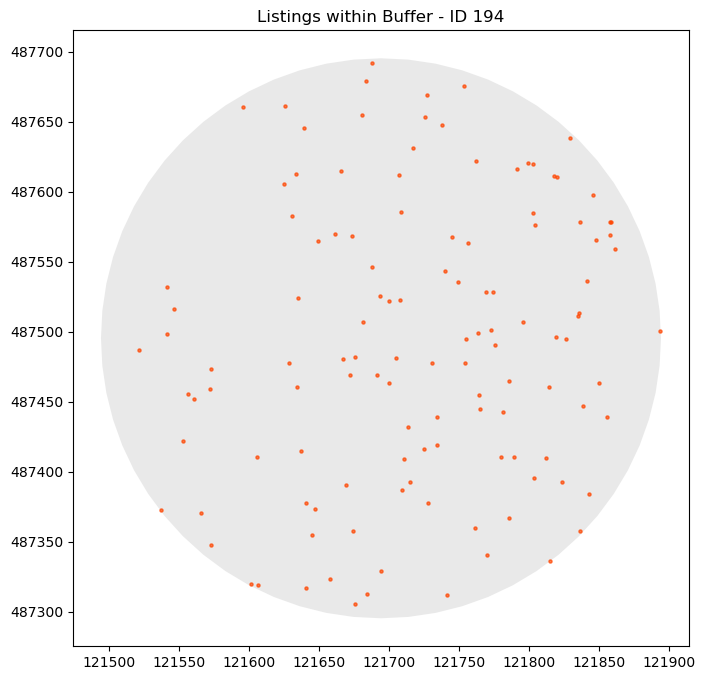

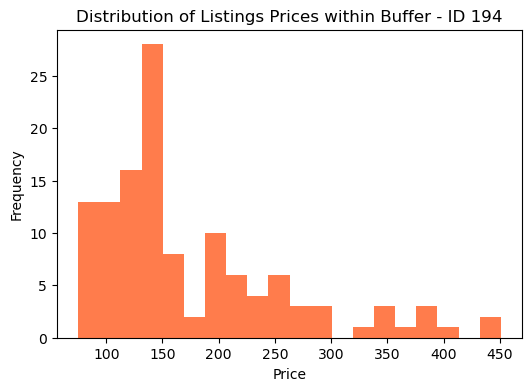

In [25]:
import geopandas as gpd
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 8))

# We can plot the buffer areas and its listings
filtered_buffer = historic_buffers[historic_buffers['buffer_id'] == 194].plot(ax=ax, color="#D4D4D4", alpha=0.5)

# We can overlay all listings within the filtered buffer
filtered_row.plot(ax=ax, marker='o', color="#FF4500", markersize=5, alpha=0.7)

# Make the plot nicer
ax.set_title("Listings within Buffer - ID 194")
plt.show()

# Plot a histogram of the 'price' attribute
plt.figure(figsize=(6, 4))
filtered_row['price'].plot(kind='hist', bins=20, color='#FF4500', alpha=0.7)
plt.title('Distribution of Listings Prices within Buffer - ID 194')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()


In [26]:
filtered_row.explore("price", cmap='Oranges', tiles='Esri_WorldGrayCanvas', zoom_start=17)
#See here all the list of Basemap ( tiles) options: https://leaflet-extras.github.io/leaflet-providers/preview/

# Folium 

Folium is a helpful library that facilitates the creation of interactive maps in Python. It allows you to visualize data on an interactive leaflet map, which can be easily manipulated. With Folium, you can bind data to a map for choropleth visualizations, and pass rich vector, raster and HTML visualizations as markers on the map. You can learn more about this library by visiting https://python-visualization.github.io/folium/latest/.




In [27]:
import folium
from folium import plugins
from folium.plugins import MeasureControl
from branca.colormap import linear
from branca import colormap
from branca import colormap as cm

In [ ]:
lon, lat = -38.625, -12.875

zoom_start = 8

folium.Map(location=[lat, lon], tiles="OpenStreetMap", zoom_start=zoom_start)

In [ ]:
folium.Map(location=[lat, lon], tiles="Cartodb Positron", zoom_start=zoom_start)


In [ ]:
folium.Map(location=[lat, lon], tiles="Cartodb dark_matter", zoom_start=zoom_start)

https://leaflet-extras.github.io/leaflet-providers/preview/ Here you can get the list of all the supported tiles

In [31]:
filtered_row.head()

,id,neighbourhood_cleansed,latitude,longitude,property_type,room_type,bedrooms,price,number_of_reviews,geometry,index_right,buffer_id
1244,735290,Centrum-West,52.374900,4.900559,Apartment,Entire home/apt,1.0,111.0,18,POINT (121861.108 487558.728),194,194
1249,10198226,Centrum-West,52.374322,4.900047,Apartment,Entire home/apt,0.0,159.0,5,POINT (121825.770 487494.574),194,194
1259,694850,Centrum-West,52.373054,4.897406,Apartment,Private room,1.0,85.0,309,POINT (121644.997 487354.752),194,194
1261,13584858,Centrum-West,52.373557,4.899852,Bed & Breakfast,Private room,1.0,136.0,0,POINT (121811.968 487409.552),194,194
1262,286500,Centrum-West,52.374970,4.898844,Apartment,Private room,1.0,111.0,103,POINT (121744.393 487567.225),194,194


In [ ]:
m = folium.Map([52.368152,4.897582], zoom_start=10)
location=filtered_row[["latitude","longitude"]]

plugins.MarkerCluster(location).add_to(m)
m

# Clic the cluster.

In [ ]:
folium.plugins.HeatMap(filtered_row[["latitude","longitude"]]).add_to(m)
m

# Challenge 2

Now is your turn to find, read, process and then make a comprehensive descriptive statistics analysis based on the previous resources and others you might need to look at. Create insightful visualizations combining both maps and charts to convey meaningful information about a chosen city.

1. Define a problem within the urban environment and choose a dataset related to urban life or city dynamics. This could include data on crime rates, housing prices, transportation, demographics, or any other urban-related dataset.
2. Get the data ideally using an **API, or web services**. But it's fine if you need to download the data. Describe why you had to use the traditional  method.
3. Work with the data cleaning and pre-processing, check for missing values, convert data types, and perform any other necessary preprocessing steps. You have the code for that in this and previous labs.
4. Use Pandas to calculate descriptive statistics such as `mean`, `median`, `standard deviation`, and other relevant measures. Explore `correlations` between different variables (Include at least one `univariate` and `bivariate` plots) 
6. Create at least one (or more) interactive map to visualize spatial aspects of the data. For example, plot crime rates across different neighbourhoods or visualize housing prices.
7. Complement with additional charts (line charts, bar charts, etc.) to extend the map and highlight key trends or patterns in the data.
8. As always, document well what you are doing and how you use `descriptive statistics and map visualizations` to extract insights from the data.
> You could try explaining any observed patterns, trends, or correlations, whether they are spatial or non-spatial. **Keep in mind** the defined problem and whether your analysis provides the required insights (Your conclusion could be that you need more data or another type of analysis)

Question 1:

The problem I am investigating is the availability of bike parking in edinburgh and its distribution throughout the city centre. Additionally, the role of the bike park capacity plays a key role in assessing its distribution and the suitability of current bit parking capacity. This is especially important in cities at the moment given the push to reduce emissions, and subsequent growth in the popularity of cycling in recent years as an "environmentally friendly" mode of transport

In [55]:
# uploading the data using an api in geojson format to a gpd
# the data is taken from: https://data.edinburghcouncilmaps.info/datasets/cityofedinburgh::cycle-parking-1/about

cycle_api = gpd.read_file("https://services-eu1.arcgis.com/FgpikkYuSUOuITxp/arcgis/rest/services/Cycle_Parking/FeatureServer/46/query?outFields=*&where=1%3D1&f=geojson", driver="geojson")

cycle_api.head()

,OBJECTID,eastings,northings,bicycle_pa,capacity,covered,access,fee,operator,CECLand,geometry
0,1,319239,672708,,0,yes,customers,,,,POINT (-3.29451 55.94060)
1,2,322573,674577,stands,16,no,,,,,POINT (-3.24169 55.95794)
2,3,317660,669330,,10,,,,,,POINT (-3.31875 55.90999)
3,4,324248,671834,,0,,,,,,POINT (-3.21410 55.93357)
4,5,325711,673108,stands,8,no,,,City of Edinburgh Council,Y,POINT (-3.19104 55.94524)


In [59]:
# clean the data 
import numpy as np

# select only columns that are relevant 
cycle_subset = cycle_api[["eastings", "northings", "OBJECTID", "bicycle_pa", "capacity", "geometry"]]

# assign empty cells with ' ' value and then remove them from the dataset 
cycle_clean = cycle_subset.replace(' ', np.nan, regex=True)
cycle_subset = cycle_clean.dropna()

cycle_subset.head()

,eastings,northings,OBJECTID,bicycle_pa,capacity,geometry
1,322573,674577,2,stands,16,POINT (-3.24169 55.95794)
4,325711,673108,5,stands,8,POINT (-3.19104 55.94524)
5,326001,672874,6,building,64,POINT (-3.18633 55.94319)
6,318395,671255,7,stands,10,POINT (-3.30758 55.92741)
7,325277,672366,8,stands,6,POINT (-3.19778 55.93851)


In [60]:
# calculating and comparing descriptive statistics for the dataframe 

#mean
mean = cycle_subset['capacity'].mean()
print(mean)

#standard deviation
std = cycle_subset['capacity'].std()
print(std)

#median
median = cycle_subset['capacity'].median()
print(median)

12.29721595184349
17.49194306137876
8.0


In [61]:
# using groupby to compare the capacity of different cycle parking types
capacity_by_type = cycle_subset.groupby('bicycle_pa')['capacity'].mean().reset_index()
capacity_by_type

,bicycle_pa,capacity
0,anchors,5.250000
1,artistic,82.000000
2,bollard,2.000000
3,building,52.100000
4,front_wheel,7.000000
5,ground_slots,10.666667
6,hoop,2.000000
7,lockers,7.400000
8,post_hoop,2.000000
9,rack,16.340426


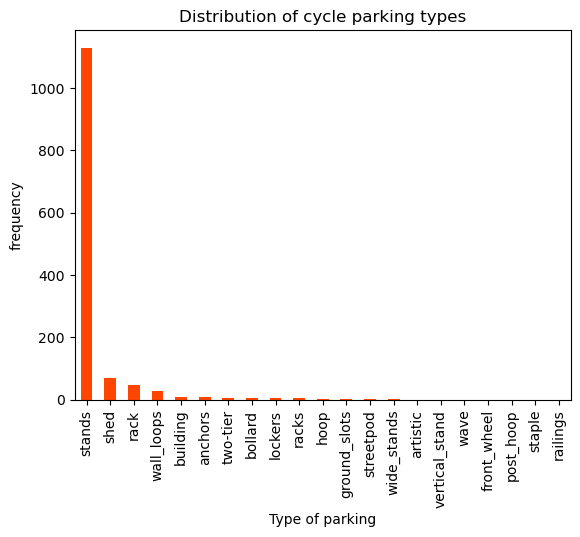

In [109]:
# bar chart of parking type 

import matplotlib.pyplot as plt

cycle_subset['bicycle_pa'].value_counts().plot(kind='bar', color='#FF4500')
plt.title('Distribution of cycle parking types')
plt.xlabel('Type of parking')
plt.ylabel('frequency')
plt.show()

# this finds that stands are the most common type of cycle parking in Edinburgh.

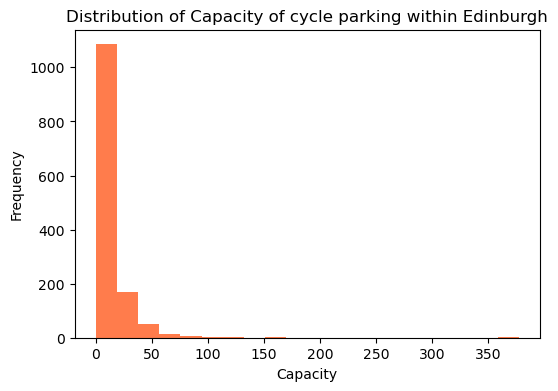

In [111]:
# making a histogram of capacity of cycle parking and frequency


plt.figure(figsize=(6, 4))
cycle_subset['capacity'].plot(kind='hist', bins=20, color='#FF4500', alpha=0.7)
plt.title('Distribution of Capacity of cycle parking within Edinburgh')
plt.xlabel('Capacity')
plt.ylabel('Frequency')
plt.show()

<Figure size 1800x1000 with 0 Axes>

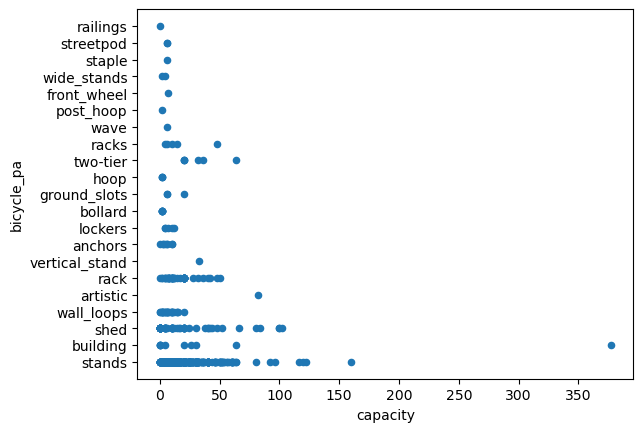

In [131]:
# bivariate plot

plt.figure(figsize=(18,10))
cycle_subset.plot(x='capacity', y='bicycle_pa', kind='scatter')
plt.show()

In [62]:
# what is the crs of the gdf?

print(cycle_subset.crs)

EPSG:4326


In [63]:
# explore spatial distribution of the data

cycle_subset.explore()
# initial exploration shows that cycle parking is mainly distributed in the city centre of Edinburgh, as well as 
#a strong cluster extending into the Leith area

In [78]:
# read a file of edinburgh's neighbourhood areas to help better analyse spatial patters

neighbourhoods = gpd.read_file("Data/Data_lab3/Natural_Neighbourhoods.geojson", driver="GeoJSON")
neighbourhoods.head()

,OBJECTID,NATURALCOM,OID_,CNT_NATURA,DUMMY_,SUM_ELECNO,Z009_ELEC,Shapearea,Shapelen,geometry
0,1,Brunstane/Gilberstoun,1485,1485,1485,1485.30,1485,1.147451e+06,4629.409487,"POLYGON ((-3.10276 55.94435, -3.10276 55.94435..."
1,2,Newcraighall,262,262,262,261.77,262,4.414281e+05,3515.734273,"MULTIPOLYGON (((-3.09979 55.93598, -3.09855 55..."
2,3,Magdalene,1479,1479,1479,1478.53,1479,3.119711e+05,2590.027278,"POLYGON ((-3.10240 55.94088, -3.10245 55.94165..."
3,4,Newbridge,327,327,327,326.84,327,5.567828e+06,11661.263206,"POLYGON ((-3.41296 55.95159, -3.41414 55.95153..."
4,5,Cammo/Strathalmond,874,874,874,873.59,874,2.008664e+06,7150.150690,"POLYGON ((-3.33979 55.96428, -3.34210 55.96406..."


In [102]:
neighbourhoods_clean = neighbourhoods[["OBJECTID", "NATURALCOM", "geometry"]]

spatial_join = projected_cycle.sjoin(neighbourhoods_clean, how="inner", predicate="intersects")
spatial_join.head()

,eastings,northings,OBJECTID_left,bicycle_pa,capacity,geometry,index_right,OBJECTID_right,NATURALCOM
1,322573,674577,2,stands,16,POINT (-3.24169 55.95794),78,79,Craigleith
4,325711,673108,5,stands,8,POINT (-3.19104 55.94524),90,91,Southside
5,326001,672874,6,building,64,POINT (-3.18633 55.94319),90,91,Southside
6,318395,671255,7,stands,10,POINT (-3.30758 55.92741),106,107,Bankhead
7,325277,672366,8,stands,6,POINT (-3.19778 55.93851),87,88,Marchmont


In [150]:
# create a gdf for the number of cycle parking per neighbourhood

parking_per_neighbourhood = spatial_join.groupby('NATURALCOM').size().reset_index(name='parking_per_neighbourhood')
parking_per_neighbourhood

,NATURALCOM,parking_per_neighbourhood
0,Abbeyhill,6
1,Alnwickhill,2
2,Baberton,1
3,Balerno,5
4,Balgreen/Saughtonhall,5
...,...,...
123,Turnhouse,2
124,Wardie Bay,2
125,Warriston,2
126,West End,14


In [151]:
# focusing on a specific neighbourhood

filtered_row = spatial_join[spatial_join['NATURALCOM'] =="New Town"]
filtered_row.explore()

# New Town was chosen as it is the CBD of edinburgh and based on analysis of the inital map, there is a high concentration in this area

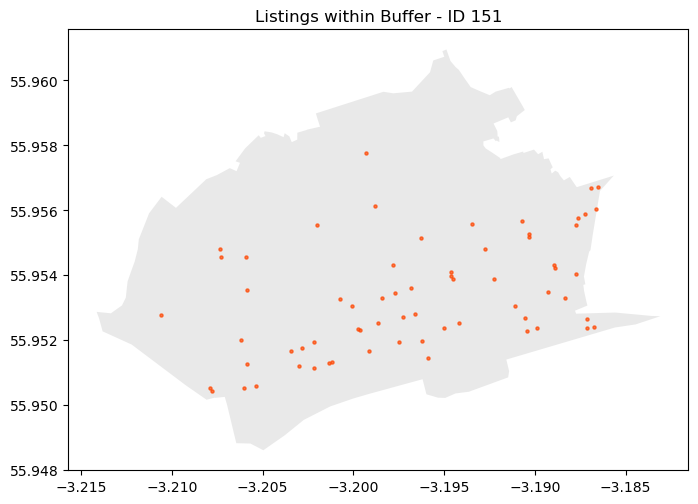

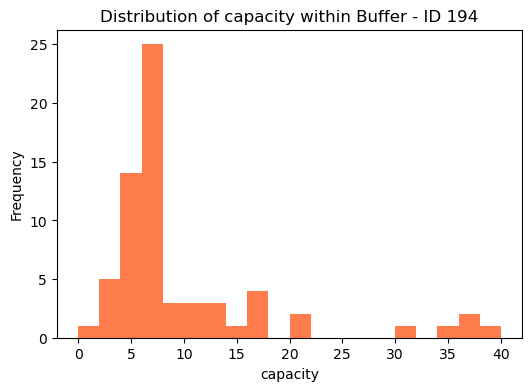

In [152]:
import geopandas as gpd
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 8))

# We can plot the buffer areas and its listings
filtered_area = neighbourhoods[neighbourhoods['NATURALCOM'] == "New Town"].plot(ax=ax, color="#D4D4D4", alpha=0.5)

# We can overlay all listings within the filtered buffer
filtered_row.plot(ax=ax, marker='o', color="#FF4500", markersize=5, alpha=0.7)

# Make the plot nicer
ax.set_title("Listings within Buffer - ID 151")
plt.show()

# Plot a histogram of the 'capacity' attribute
plt.figure(figsize=(6, 4))
filtered_row['capacity'].plot(kind='hist', bins=20, color='#FF4500', alpha=0.7)
plt.title('Distribution of capacity within Buffer - ID 194')
plt.xlabel('capacity')
plt.ylabel('Frequency')
plt.show()

In [153]:
# the above plot shows that while there are a large number of cycle parking units in New Town, the majority have a small
#capacity with only 5 extending past a capacity of 20

In [132]:
import folium
from folium import plugins
from folium.plugins import MeasureControl
from branca.colormap import linear
from branca import colormap
from branca import colormap as cm

In [149]:
# plot a heat map using folium showing the distribution of cycle parking accross edinburgh
# info taken from: https://geopandas.org/en/stable/gallery/plotting_with_folium.html

map = folium.Map(location=[55.9533, 3.1883], tiles="OpenStreetMap", zoom_start=6)

cycle_heat_map = [[point.xy[1][0], point.xy[0][0]] for point in cycle_subset.geometry]

cycle_heat_map
plugins.HeatMap(cycle_heat_map).add_to(map)

map

In [155]:
# overall, to draw further insights about the current provision of bike parking accross edinburgh, further data is required
# such as how often each of these bike parking units are used and what ones frequently exceed their capacity.
# This would allow Edinburgh council to use a more targetted approach to assessing their bike parking provision. 
# Additionally, further insights could be drawn about the suitability of the location of these spots, as well as where
# best to build more.

# Dealing with big data sets

You have likely noticed the difficulties we face when attempting to plot data using traditional libraries with built-in mapping representation methods. Every time a new variable is loaded, your computer's memory pool becomes increasingly crowded. As spatial data scientists, we may end up consuming all of our available RAM, causing Jupyter to become stuck. Additionally, the notebooks become quite large in size, and it becomes difficult to push the final version into platforms like GitHub.

In such cases, desktop tools are typically more efficient when it comes to manipulating and handling a certain amount of data, but they, too, can become stuck. These programs, such as `QGIS`, `ArcGIS`, and even `R`, struggle to handle large datasets, especially those with over a million records. Therefore, we need to consider alternative methods for processing and plotting data.

> If you took the GG3209 module last semestre you will be familiar with this section

# Lonboard

Now, we can download big data sets related to reported crime in the UK. This data can be found in the following link https://data.police.uk/data/, you can select a range of times and then the force that you would like to get the data. For this example, we can download the reported crime from **Jan 2023 to Dec 2023** collected by the Metropolitan Police Service.

> Please **go to this website and download the data**, place the zip file in your data folder and keep working with the notebook. Once you unzip and merge all the files from Jan to Dec 2023, you should get approximately 1.135.031 records.

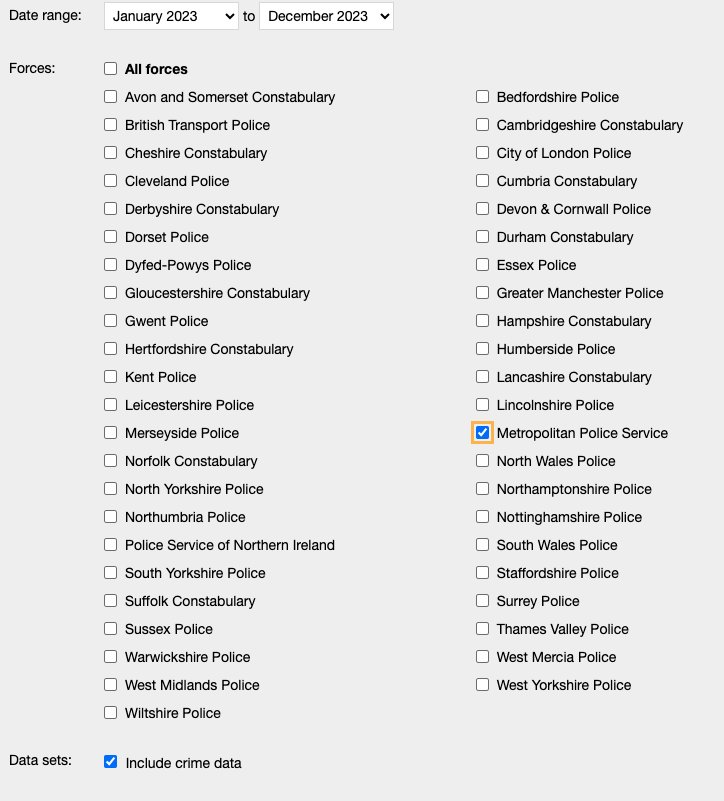



We need to unzip, go through all the sub-directories and then merge all the CSV files included.



In [158]:
import zipfile
import os
import pandas as pd

# Unzip the file. YOU NEED TO UPDATE THIS PATH based on where you place the zip file.
with zipfile.ZipFile('Data/Data_lab3/crime_data.zip', 'r') as zip_ref:
    zip_ref.extractall('CrimeData')

# List all .csv files in subdirectories
# Here we use https://docs.python.org/dev/library/pathlib.html and walk https://docs.python.org/dev/library/os.html#os.walk
csv_files = [os.path.join(root, file) for root, dirs, files in os.walk('CrimeData/crime_data') for file in files if file.endswith('.csv')]

# If you notice, the files are included in separate folders; we need to merge (concat) those.
crimes_london = pd.concat([pd.read_csv(csv_file) for csv_file in csv_files], ignore_index=True)

crimes_london.head()

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,260968c6eec09d2ca5a0a895453cbeba1d429eb662022b...,2023-10,Metropolitan Police Service,Metropolitan Police Service,-0.534527,50.827329,On or near Banks Gardens,E01034816,Arun 004F,Drugs,Investigation complete; no suspect identified,NaN
1,8fdc14d25654b44657d67659b4699bc8e52c50666f18f2...,2023-10,Metropolitan Police Service,Metropolitan Police Service,0.853458,51.126012,On or near Augustus Walk,E01024008,Ashford 009D,Violence and sexual offences,Investigation complete; no suspect identified,NaN
2,NaN,2023-10,Metropolitan Police Service,Metropolitan Police Service,0.140194,51.582356,On or near Hatch Grove,E01000027,Barking and Dagenham 001A,Anti-social behaviour,NaN,NaN
3,NaN,2023-10,Metropolitan Police Service,Metropolitan Police Service,0.140194,51.582356,On or near Hatch Grove,E01000027,Barking and Dagenham 001A,Anti-social behaviour,NaN,NaN
4,NaN,2023-10,Metropolitan Police Service,Metropolitan Police Service,0.134947,51.588063,On or near Mead Grove,E01000027,Barking and Dagenham 001A,Anti-social behaviour,NaN,NaN


You should have more than 1M of records.

In [159]:
crimes_london.shape

(1135031, 12)

In [160]:
crimes_london.columns

Index(['Crime ID', 'Month', 'Reported by', 'Falls within', 'Longitude',
       'Latitude', 'Location', 'LSOA code', 'LSOA name', 'Crime type',
       'Last outcome category', 'Context'],
      dtype='object')

Let's filter the requiered columns, and then geo-locate the outcome.

In [161]:
subset_crimes = crimes_london[['Reported by', 
                            'Longitude',
                            'Latitude',
                            'LSOA code',
                            'LSOA name',
                            'Crime type',
                           ]]

# Remove any records that are not complete
subset_crimes = subset_crimes.dropna()
# We need a crime_id attribute.

subset_crimes['crime_id'] = range(len(subset_crimes))


In [162]:
subset_crimes.head()

,Reported by,Longitude,Latitude,LSOA code,LSOA name,Crime type,crime_id
0,Metropolitan Police Service,-0.534527,50.827329,E01034816,Arun 004F,Drugs,0
1,Metropolitan Police Service,0.853458,51.126012,E01024008,Ashford 009D,Violence and sexual offences,1
2,Metropolitan Police Service,0.140194,51.582356,E01000027,Barking and Dagenham 001A,Anti-social behaviour,2
3,Metropolitan Police Service,0.140194,51.582356,E01000027,Barking and Dagenham 001A,Anti-social behaviour,3
4,Metropolitan Police Service,0.134947,51.588063,E01000027,Barking and Dagenham 001A,Anti-social behaviour,4



After the initial pre-processing, you have significantly less amount of data records. 







In [163]:
subset_crimes.shape

(1111443, 7)

In [164]:
import geopandas as gpd

geometry = gpd.points_from_xy(subset_crimes['Longitude'], subset_crimes['Latitude'])
geo_crimes = gpd.GeoDataFrame(subset_crimes, geometry=geometry, crs='EPSG:4326')
geo_crimes.head()

,Reported by,Longitude,Latitude,LSOA code,LSOA name,Crime type,crime_id,geometry
0,Metropolitan Police Service,-0.534527,50.827329,E01034816,Arun 004F,Drugs,0,POINT (-0.53453 50.82733)
1,Metropolitan Police Service,0.853458,51.126012,E01024008,Ashford 009D,Violence and sexual offences,1,POINT (0.85346 51.12601)
2,Metropolitan Police Service,0.140194,51.582356,E01000027,Barking and Dagenham 001A,Anti-social behaviour,2,POINT (0.14019 51.58236)
3,Metropolitan Police Service,0.140194,51.582356,E01000027,Barking and Dagenham 001A,Anti-social behaviour,3,POINT (0.14019 51.58236)
4,Metropolitan Police Service,0.134947,51.588063,E01000027,Barking and Dagenham 001A,Anti-social behaviour,4,POINT (0.13495 51.58806)


To plot more than 1 million points, traditional methods are not a good choice. Instead, we can use advanced libraries like [lonboard](https://developmentseed.org/lonboard/latest/) to create a layer variable that utilizes the `geo_crimes` and plot it on an interactive map. This library offers two methods: `viz(gdf)` - a quick method to plot big datasets, and `ScatterplotLayer` - a method that provides more control over the layer's appearance. With this method, we can create a `layer` and customize its visualization using other methods in the library. Additionally, we can load several layers, including lines and polygons.

>Uncomment and run the next line once you install lonboard. Ideally this libary should be part of the UA environment we have or we can run the same line in another terminal, before lauching Jupyter.

In [ ]:
#pip install lonboard

In [ ]:
#pip install pyarrow

In [165]:
from lonboard import viz
viz(geo_crimes)

Map(basemap_style=<CartoBasemap.DarkMatter: 'https://basemaps.cartocdn.com/gl/dark-matter-gl-style/style.json'…

You are mapping more than 1M of records, if you want you can try that in QGIS or R and let me know the results

In [166]:
from lonboard import Map, ScatterplotLayer

layer = ScatterplotLayer.from_geopandas(geo_crimes)
map = Map(layers=[layer], _height=500)
map

Map(custom_attribution='', layers=(ScatterplotLayer(table=arro3.core.Table
-----------
Reported by: Utf8
Longi…

if you get an error, go to the documentation website and see what are you missing: https://developmentseed.org/lonboard/latest/api/layers/scatterplot-layer/

## Customizing the Layer

Now, we can customize the previous layer by plotting by `Crime type` in an initial attempt to unhide any spatial pattern. Let's initially check how many categories we have in this `Crime type` column.


In [167]:
crime_type = geo_crimes['Crime type'].value_counts()
crime_type

Crime type
Violence and sexual offences    259632
Anti-social behaviour           222846
Other theft                     132381
Vehicle crime                   103281
Theft from the person            70171
Public order                     56626
Shoplifting                      56516
Criminal damage and arson        56182
Burglary                         54995
Drugs                            35810
Robbery                          31939
Bicycle theft                    15811
Other crime                      10359
Possession of weapons             4894
Name: count, dtype: int64

<Axes: ylabel='Crime type'>

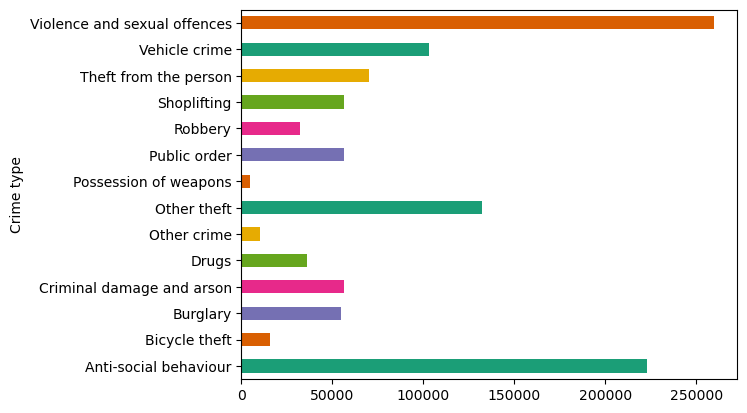

In [168]:
import seaborn as sns
geo_crimes.groupby('Crime type').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

We can see that `Violence and sexual offences ` are the Crime Types with more reports. now, let's see if we can see any spatial pattern by plotting those categories in our previously loaded map. We need to assign a colour to each crime type to do this. We can do that by creating an array of all the unique categories.

In [169]:
categories = geo_crimes['Crime type'].unique()
colors = sns.color_palette("bright", len(categories))
colors

[(0.00784313725490196, 0.24313725490196078, 1.0),
 (1.0, 0.48627450980392156, 0.0),
 (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 (0.9098039215686274, 0.0, 0.043137254901960784),
 (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 (0.6235294117647059, 0.2823529411764706, 0.0),
 (0.9450980392156862, 0.2980392156862745, 0.7568627450980392),
 (0.6392156862745098, 0.6392156862745098, 0.6392156862745098),
 (1.0, 0.7686274509803922, 0.0),
 (0.0, 0.8431372549019608, 1.0),
 (0.00784313725490196, 0.24313725490196078, 1.0),
 (1.0, 0.48627450980392156, 0.0),
 (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 (0.9098039215686274, 0.0, 0.043137254901960784)]

Now using the same principle, we can use Numpy to create a matrix that group every `Crime type` with its correspondant `color code. ` This code will use the coding `RGBA(Red, Green, Blue,Alpha)` the last value corresponde to transparency.

In [170]:
# Get unique categories
categories = geo_crimes['Crime type'].unique()

# colour seaborn's "tab10" color palette
colors = sns.color_palette("bright", len(categories))

# We create a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

{'Drugs': (0.00784313725490196, 0.24313725490196078, 1.0),
 'Violence and sexual offences': (1.0, 0.48627450980392156, 0.0),
 'Anti-social behaviour': (0.10196078431372549,
  0.788235294117647,
  0.2196078431372549),
 'Other theft': (0.9098039215686274, 0.0, 0.043137254901960784),
 'Public order': (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 'Robbery': (0.6235294117647059, 0.2823529411764706, 0.0),
 'Vehicle crime': (0.9450980392156862, 0.2980392156862745, 0.7568627450980392),
 'Shoplifting': (0.6392156862745098, 0.6392156862745098, 0.6392156862745098),
 'Criminal damage and arson': (1.0, 0.7686274509803922, 0.0),
 'Burglary': (0.0, 0.8431372549019608, 1.0),
 'Bicycle theft': (0.00784313725490196, 0.24313725490196078, 1.0),
 'Theft from the person': (1.0, 0.48627450980392156, 0.0),
 'Possession of weapons': (0.10196078431372549,
  0.788235294117647,
  0.2196078431372549),
 'Other crime': (0.9098039215686274, 0.0, 0.043137254901960784)}

With this new array filled of the code colours we need per Crime type category. We can then use the layer. properties, e.g, `radius_scale`, `opacity`, and `get_fill_color`. You need to coe back to the map to see the customised layer in the map we plot previously.

In [171]:
import numpy as np
color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in geo_crimes['Crime type']],
                       dtype=np.uint8)
color_array

array([[  2,  62, 255, 255],
       [255, 124,   0, 255],
       [ 26, 201,  56, 255],
       ...,
       [ 26, 201,  56, 255],
       [159,  72,   0, 255],
       [  0, 215, 255, 255]], dtype=uint8)

In [172]:
layer.radius_scale = 40
layer.opacity = 0.05
layer.get_fill_color = color_array

> to see the updated and coloured map you need to scroll up and see the plot map we previously created.

The Metropolitan Police Service collects data from multiple areas, so the map includes data from areas outside London; we could define a new bounding box to focus only on the Central London area.

In [173]:
geo_crimes.total_bounds

array([-5.65517 , 50.04211 ,  1.742037, 55.498371])

By using the tool https://norbertrenner.de/osm/bbox.html to get the precise boundary box you need to spatially filter your analysis and remove any outlier rows that are not located in the area of interest. 

In [174]:
import shapely
ld_bbox = [-0.591,51.285,0.381,51.678] # London B. Box
geo_crimes_london = geo_crimes[geo_crimes.intersects(shapely.box(*ld_bbox))]
geo_crimes_london.shape

(1107902, 8)

In [ ]:
layer = ScatterplotLayer.from_geopandas(geo_crimes_london)
map = Map(layers=[layer], _height=500)
map

# PyDeck

deck.gl is a **WebGL-powered** framework for visual exploratory data analysis of large datasets. You can install the entire framework on you computer an run it locally, which will be the rigth way if you are creating an app from scratch. Here we will use PyDeck, which is a set of Python bindings for making spatial visualizations with **deck.gl**, optimized for a Jupyter environment. See the documentation: https://pydeck.gl/

> First, we need to install the library in our UTA environment, something you are already familiar with. Uncomment the next code cell and run it only once.


In [20]:
#pip install pydeck

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 6.0 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


If you have issues installing it, please visit: https://pydeck.gl/installation.html or ask for an appoinment to get extra help.

In [176]:
import pydeck as pdk

# 2014 locations of car accidents in the UK
UK_ACCIDENTS_DATA = ('https://raw.githubusercontent.com/uber-common/'
                     'deck.gl-data/master/examples/3d-heatmap/heatmap-data.csv')

#This data has already been curated and adapted to this example. In the real world, you need to do the data cleaning and pre-processing part.

In [177]:
# Define a layer to display on a map
layer = pdk.Layer(
    'HexagonLayer',
    UK_ACCIDENTS_DATA,
    get_position=['lng', 'lat'],
    auto_highlight=True,
    elevation_scale=50,
    pickable=True,
    elevation_range=[0, 3000],
    extruded=True,                 
    coverage=1)

In [178]:
# Set the viewport location, see here for more properties https://pydeck.gl/view_state.html?highlight=viewstate#pydeck.bindings.view_state.ViewState
view_state = pdk.ViewState(
    longitude=-1.415,
    latitude=52.2323,
    zoom=6,
    min_zoom=5,
    max_zoom=15,
    pitch=40.5,
    bearing=-27.36)

In [ ]:
# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html('MyGeoApp.html')
# NOTE: You are creating an HTML ( website with this app) so you can see them out of the Jupyter environment. 

# Challenge 3

1. Go to https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95/about_data 
2. Get the data for Motor Vehicle Collisions - Crashes Jan 2024. The dataset contains 2.06 M of records.
3. Use the API endpoint to map the data (e.g. https://data.cityofnewyork.us/resource/h9gi-nx95.json) 
   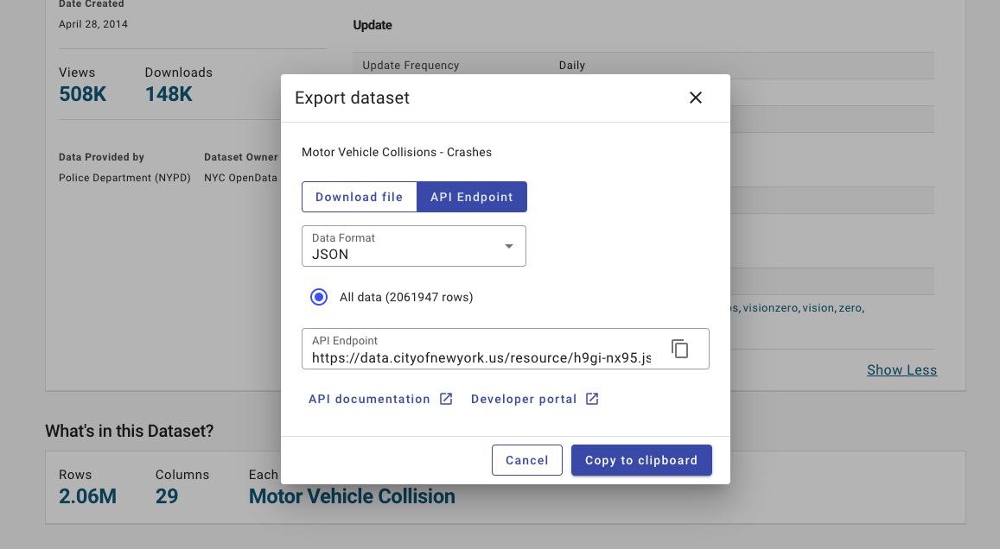
4. Customize the map by representing the data by `number_of_persons_killed` and `number_of_cyclist_killed`
5. Finally, calculate descriptive statistics for at least two attributes, such as `mean`, `standard deviation`, and other relevant measures 6. Justify/Describe the attribute selection.
7. Plot correlations between the chosen attributes and create `univariate` and/or `multivariate` charts to justify your insights.
   > Please take note that the dataset includes various numerical values. Hence, each student's attribute selection, justification, charts, and maps are expected to vary. 

In [213]:
crash_data = pd.read_csv("Data/Data_lab3/Motor_Vehicle_Collisions_-_Crashes_20250223.csv")
crash_data.head()

# api data could only be downloaded with 1000 rows, therefore I downloaded the csv file into my data lab 3 folder

/var/folders/d1/m4w3nsnj6k5_lmftsj71l4j40000gn/T/ipykernel_5818/1312753677.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  crash_data = pd.read_csv("Data/Data_lab3/Motor_Vehicle_Collisions_-_Crashes_20250223.csv")


,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,09/11/2021,2:39,NaN,NaN,NaN,NaN,NaN,WHITESTONE EXPRESSWAY,20 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,4455765,Sedan,Sedan,NaN,NaN,NaN
1,03/26/2022,11:45,NaN,NaN,NaN,NaN,NaN,QUEENSBORO BRIDGE UPPER,NaN,NaN,...,NaN,NaN,NaN,NaN,4513547,Sedan,NaN,NaN,NaN,NaN
2,11/01/2023,1:29,BROOKLYN,11230.0,40.62179,-73.970024,"(40.62179, -73.970024)",OCEAN PARKWAY,AVENUE K,NaN,...,Unspecified,Unspecified,NaN,NaN,4675373,Moped,Sedan,Sedan,NaN,NaN
3,06/29/2022,6:55,NaN,NaN,NaN,NaN,NaN,THROGS NECK BRIDGE,NaN,NaN,...,Unspecified,NaN,NaN,NaN,4541903,Sedan,Pick-up Truck,NaN,NaN,NaN
4,09/21/2022,13:21,NaN,NaN,NaN,NaN,NaN,BROOKLYN BRIDGE,NaN,NaN,...,Unspecified,NaN,NaN,NaN,4566131,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN


In [216]:
crash_data.columns
# work out the columns available to allow for cleaning the dataset 


Index(['CRASH DATE', 'CRASH TIME', 'BOROUGH', 'ZIP CODE', 'LATITUDE',
       'LONGITUDE', 'LOCATION', 'ON STREET NAME', 'CROSS STREET NAME',
       'OFF STREET NAME', 'NUMBER OF PERSONS INJURED',
       'NUMBER OF PERSONS KILLED', 'NUMBER OF PEDESTRIANS INJURED',
       'NUMBER OF PEDESTRIANS KILLED', 'NUMBER OF CYCLIST INJURED',
       'NUMBER OF CYCLIST KILLED', 'NUMBER OF MOTORIST INJURED',
       'NUMBER OF MOTORIST KILLED', 'CONTRIBUTING FACTOR VEHICLE 1',
       'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3',
       'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5',
       'COLLISION_ID', 'VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
       'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5'],
      dtype='object')

In [233]:
# create a subset to remove problematic or irrelevant columns

crash_clean = crash_data[['CRASH DATE', 'LATITUDE',
                           'LONGITUDE', 'LOCATION',
                           'NUMBER OF PERSONS INJURED',
                           'NUMBER OF PERSONS KILLED', 'NUMBER OF PEDESTRIANS INJURED',
                           'NUMBER OF PEDESTRIANS KILLED', 'NUMBER OF CYCLIST INJURED',
                           'NUMBER OF CYCLIST KILLED', 'NUMBER OF MOTORIST INJURED',
                           'NUMBER OF MOTORIST KILLED', 'CONTRIBUTING FACTOR VEHICLE 1',
                           'COLLISION_ID']]

In [235]:
# remove any null values from the lat or long columns and assign an id to each crash

subset_crash = crash_clean.dropna(subset=['LATITUDE', 'LONGITUDE'])


In [236]:
# make into a gdf
import geopandas as gpd

geometry = gpd.points_from_xy(subset_crash['LONGITUDE'], subset_crash['LATITUDE'])
crash_gdf = gpd.GeoDataFrame(subset_crash, geometry=geometry, crs='EPSG:4326')
crash_gdf.head()

,CRASH DATE,LATITUDE,LONGITUDE,LOCATION,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,CONTRIBUTING FACTOR VEHICLE 1,COLLISION_ID,geometry
2,11/01/2023,40.621790,-73.970024,"(40.62179, -73.970024)",1.0,0.0,0,0,0,0,1,0,Unspecified,4675373,POINT (-73.97002 40.62179)
9,09/11/2021,40.667202,-73.866500,"(40.667202, -73.8665)",0.0,0.0,0,0,0,0,0,0,Unspecified,4456314,POINT (-73.86650 40.66720)
10,12/14/2021,40.683304,-73.917274,"(40.683304, -73.917274)",0.0,0.0,0,0,0,0,0,0,NaN,4486609,POINT (-73.91727 40.68330)
12,12/14/2021,40.709183,-73.956825,"(40.709183, -73.956825)",0.0,0.0,0,0,0,0,0,0,Passing Too Closely,4486555,POINT (-73.95682 40.70918)
13,12/14/2021,40.868160,-73.831480,"(40.86816, -73.83148)",2.0,0.0,0,0,0,0,2,0,Unspecified,4486660,POINT (-73.83148 40.86816)


In [237]:
# plot the data using lonboard 

from lonboard import Map, ScatterplotLayer
import seaborn as sns 

layer = ScatterplotLayer.from_geopandas(crash_gdf)
map = Map(layers=[layer], _height=500)
map

Map(custom_attribution='', layers=(ScatterplotLayer(table=arro3.core.Table
-----------
CRASH DATE: Utf8
LATITU…

In [239]:
crash_gdf['NUMBER OF PERSONS KILLED'].unique()
# check for the number of unique categories 
# --> in this instance there is either 0 people killed or 1

array([ 0.,  1.,  2.,  3.,  4., nan,  8.,  5.])

In [240]:
# get unique categories and generate the colours to be used

categories = crash_gdf['NUMBER OF PERSONS KILLED'].unique()

colors = sns.color_palette("bright")

color_dict = dict(zip(categories, colors))


In [241]:
# create an array to assign each colour a value to match the number of people killed

import numpy as np
color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255))
                        for x in crash_gdf['NUMBER OF PERSONS KILLED']],
                       dtype=np.uint8)

color_array

array([[  2,  62, 255, 255],
       [  2,  62, 255, 255],
       [  2,  62, 255, 255],
       ...,
       [  2,  62, 255, 255],
       [  2,  62, 255, 255],
       [  2,  62, 255, 255]], dtype=uint8)

In [242]:
# display this on the above map 

layer.radius_scale = 40
layer.opacity = 0.05
layer.get_fill_color = color_array

crash_gdf.total_bounds

# as seen, most of the incidents involved no deaths, therefore there it is difficult to analyse as looks mainly blue

array([-201.35999 ,    0.      ,    0.      ,   43.344444])

In [254]:
cyclist_killed = ScatterplotLayer.from_geopandas(crash_gdf)
map = Map(layers=[cyclist_killed], _height=500)
map

Map(custom_attribution='', layers=(ScatterplotLayer(table=arro3.core.Table
-----------
CRASH DATE: Utf8
LATITU…

In [255]:
# for number of cyclists killed:

categories = crash_gdf['NUMBER OF CYCLIST KILLED'].unique()
colors = sns.color_palette("bright")
color_dict = dict(zip(categories, colors))


color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255))
                        for x in crash_gdf['NUMBER OF CYCLIST KILLED']],
                       dtype=np.uint8)

color_array

array([[  2,  62, 255, 255],
       [  2,  62, 255, 255],
       [  2,  62, 255, 255],
       ...,
       [  2,  62, 255, 255],
       [  2,  62, 255, 255],
       [  2,  62, 255, 255]], dtype=uint8)

In [256]:
cyclist_killed.radius_scale = 40
cyclist_killed.opacity = 0.05
cyclist_killed.get_fill_color = color_array

crash_gdf.total_bounds

array([-201.35999 ,    0.      ,    0.      ,   43.344444])

In [257]:
# creating an overview of the descriptive statistics for each variable

descriptive_stats = subset_crash.describe()
descriptive_stats

,LATITUDE,LONGITUDE,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,COLLISION_ID
count,1.917528e+06,1.917528e+06,1.917512e+06,1.917500e+06,1.917528e+06,1.917528e+06,1.917528e+06,1.917528e+06,1.917528e+06,1.917528e+06,1.917528e+06
mean,4.061646e+01,-7.373169e+01,3.219401e-01,1.519166e-03,6.121788e-02,7.686980e-04,2.921783e-02,1.204676e-04,2.269302e-01,5.997305e-04,3.257289e+06
std,2.091131e+00,3.912561e+00,7.056114e-01,4.113498e-02,2.532841e-01,2.831049e-02,1.704420e-01,1.102253e-02,6.645925e-01,2.680064e-02,1.500840e+06
min,0.000000e+00,-2.013600e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.200000e+01
25%,4.066752e+01,-7.397466e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.205668e+06
50%,4.072049e+01,-7.392702e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.756164e+06
75%,4.076963e+01,-7.386673e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.273584e+06
max,4.334444e+01,0.000000e+00,4.300000e+01,8.000000e+00,2.700000e+01,6.000000e+00,4.000000e+00,2.000000e+00,4.300000e+01,5.000000e+00,4.793962e+06


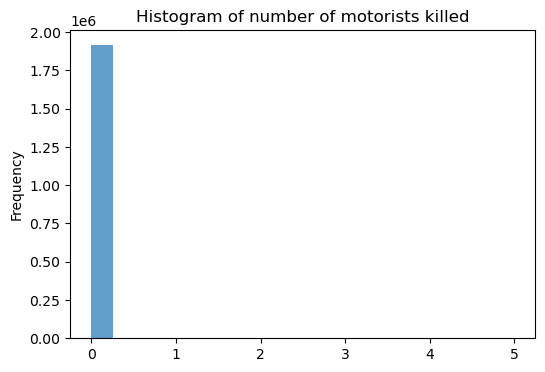

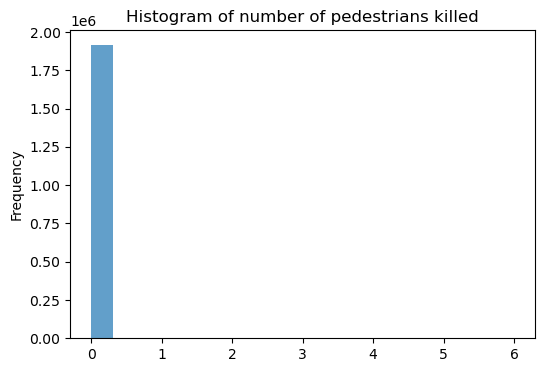

In [262]:
# visualising univariate and bivariate plots
# going to focus on 'NUMBER OF MOTORIST KILLED" AND "NUMBER OF PEDESTRIANS KILLED"

import matplotlib.pyplot as plt

plt.figure(figsize=(6,4))
subset_crash['NUMBER OF MOTORIST KILLED'].plot(kind='hist', bins=20, alpha =0.7)
plt.title('Histogram of number of motorists killed')
plt.show()

plt.figure(figsize=(6,4))
subset_crash['NUMBER OF PEDESTRIANS KILLED'].plot(kind='hist', bins=20, alpha=0.7)
plt.title('Histogram of number of pedestrians killed')
plt.show()

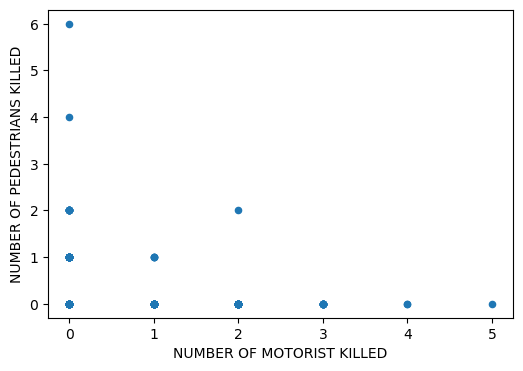

In [271]:
subset_crash.plot(x='NUMBER OF MOTORIST KILLED', y='NUMBER OF PEDESTRIANS KILLED', kind='scatter', figsize=(6,4))
plt.show()

# Datashader

Datashader is a graphics pipeline system for creating meaningful representations of large datasets quickly and flexibly. Datashader breaks the creation of images into a series of explicit steps that allow computations to be done on intermediate representations. 
There are other popular tools to represent big datasets like HoloViz; Datashader is included in this extended framework to allow researchers to represent millions of records.

## Why is mapping big data sets so complicated?

1. The speed. Plotting the 11 million data points from the below example using regular Python tools would be slow and may crash Jupyter kernel.
2. Image quality. In case a plotting library doesn't crash and you are willing to wait, it may still keep drawing each new data point as a circle or any other shape on top of each other, causing over-plotting. That is the main issue of plotting big data in GIS tools. Even if you add  transparency for overlapping points, it may not always help in this situation. Just imagine having many points displayed on top of each other on an image - what you would see it would become complicated to extract information from it.

**Datashader** provides an elegant and seemingly magic solution to these two obstacles. 


> Before you continue. I advise to save your work and **restart the kernel** as you must have a lot of your memory occupied.

Let's start with a simple example using data from the NYC Taxi data (https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page)

> For more info go to: https://examples.pyviz.org/nyc_taxi in here they use HoloViz, if time allow I will show you how to use that tool as well.

We need to make sure our Python env includes all the libraries we need. In a new terminal CD to your Working Directory/Repo and run 
`conda install holoviews hvplot datashader fastparquet python-snappy`

And then import packages:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
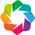

In [2]:
import holoviews as hv, pandas as pd, colorcet as cc
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

**Reading the data**:

For the very largest files, you will want to use a distributed processing library like **Dask with Datashader**, but here we have a **Parquet file** with “only” **11 million records**, which Datashader can easily handle on a laptop using Pandas without any special computing resources. Here you’ll load in two columns representing taxi drop-off locations.

In [3]:
#GeoParquet is a helpful format for loading big data sets.

df = pd.read_parquet(
    'https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq',
    columns = ['dropoff_x', 'dropoff_y']
)

In [8]:
df.head() # This will take some time, you are loading more than 11M records.

,dropoff_x,dropoff_y
0,-8234835.5,4975627.0
1,-8237020.5,4976875.0
2,-8232279.0,4986477.0
3,-8238124.0,4971127.0
4,-8238107.5,4974457.0


In [9]:
len(df)

11842094

**You have loaded 11M of records**, but now see how fast you will be able to plot all of them.

**Mapping**: 

Now we plot the data using **Datashader**. It only took four lines of code and six milliseconds to plot the 11 million rows of data, overlaid on a map of the New York area:

In [19]:
%%time
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(df, ['dropoff_x', 'dropoff_y'])
taxi_trips = datashade(points, cmap=cc.fire, width=900, height=480)
map_tiles * taxi_trips

NameError: name 'EsriImagery' is not defined

Alternatively, instead of using **thedatashade function**, You could use **hvplot** with `rasterize=True` to apply rasterization using Datashader! 

I highly recommend using `hvplot` for your visualizations.

In [18]:
import hvplot.pandas

map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = df.hvplot(
    'dropoff_x',
    'dropoff_y',
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
)
map_tiles * plot

NameError: name 'EsriImagery' is not defined

You would then be able to `zoom in` to any region of this map, with the plot dynamically updating to use the full resolution for that zoom level.


**Datashader** turns your data into a plot using the five-step pipeline we discussed in the lecture.

You can find more information about how the pipeline works in each step on the Dashader Documentation site. (https://datashader.org/user_guide/Extending.html

1. Projection
2. Aggregation
3. Transformation
4. Colormapping and,
5. Embedding.

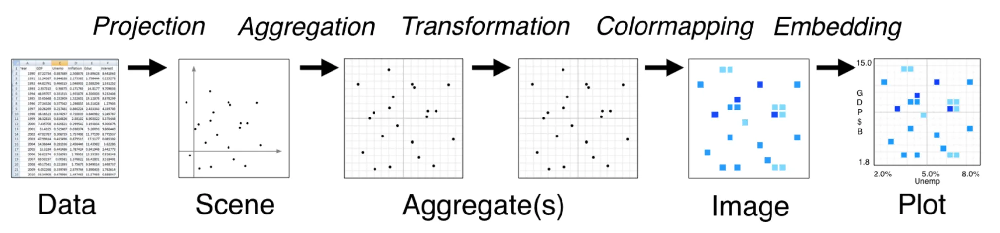
Fig 1. Datashader pipeline (Image from datashader.org).

Now we can break down each step you can see how the data is processed., Take some time to print and explore the outcomes.

In [10]:
#Importing the required libraries.
import datashader as ds
import datashader.transfer_functions as tf
from holoviews.operation.datashader import rasterize

**Projection:** First, a 2D canvas is defined with width and height for the data to be projected onto.

The canvas defines **how many pixels** we would like to see in the final image, and optionally defines the `x_range` and `y_range` that will map to these pixels. 

In this particular scenario, the data ranges needed to plot are not specified in the Canvas. However, they will be automatically filled in the next step based on the maximum and minimum values of the data x and y in the given dataframe. The projection is defined by the Canvas, but for the sake of speed, each point is projected during the aggregation step.


In [13]:
canvas = ds.Canvas(plot_width=900, plot_height=480)

**Agregation**: 

After we define the projected canvas, we project each point into the two-dimensional output grid and aggregate the results per pixel.

Datashader provides various options for data aggregation, but in this particular example, we are counting the number of data points projected into each pixel. To do this, we iterate through the data points and increment the pixel where the point lands. This creates a two-dimensional histogram that counts dropoffs per pixel.

In [14]:
canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count())

<xarray.DataArray (dropoff_y: 480, dropoff_x: 900)> Size: 2MB
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * dropoff_x  (dropoff_x) float64 7kB -8.254e+06 -8.254e+06 ... -8.21e+06
  * dropoff_y  (dropoff_y) float64 4kB 4.965e+06 4.965e+06 ... 4.989e+06
Attributes:
    x_range:  (-8254332.0, -8209813.5)
    y_range:  (4965255.5, 4988769.5)

**Transformation:** This is an optional step. 

The previous step has resulted in a fixed-size grid, regardless of the original dataset size. Once the data is in this grid, it can be transformed in any way desired, such as selecting a specific range of counts, masking data based on other datasets, or values, etc. In this case, the dropoff data ranges from zero in some pixels to tens of thousands in others. If we try to plot the grid directly, we would see only a few hotspots. Therefore, to make all the different levels visible, the data is transformed using the `image-processing` technique called **histogram equalization**. This technique reveals the distribution of the counts rather than their absolute values, making all the different levels visible, as seen in the image above.

Histogram equalization is actually folded into the colormapping step below, but we can do explicit transformations at this stage if we want, such as squaring the counts

In [16]:
import numpy as np
np.power(canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count()),2)

<xarray.DataArray (dropoff_y: 480, dropoff_x: 900)> Size: 2MB
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * dropoff_x  (dropoff_x) float64 7kB -8.254e+06 -8.254e+06 ... -8.21e+06
  * dropoff_y  (dropoff_y) float64 4kB 4.965e+06 4.965e+06 ... 4.989e+06
Attributes:
    x_range:  (-8254332.0, -8209813.5)
    y_range:  (4965255.5, 4988769.5)

**Color Mapping**

After the binning process, we can represent the binned grid data as an image. 

This is the key part, each bin value can be mapped to one of the 256 colors in a colormap, either through **linear interpolation** or an automatic transformation like applying the log function to each bin value, or using histogram equalization. 

In this example, we are using the "fire" colourmap from Colorcet. The colourmap starts with black for the lowest counts (1 and 2 dropoffs) and gradually shifts to red for higher values (in the hundreds), then yellow for even higher values (in the thousands), and finally white for the highest counts per pixel (in the tens of thousands, in this case). We set the background to black to enhance the visibility of the data.

Similar approach we did earlier with londboard

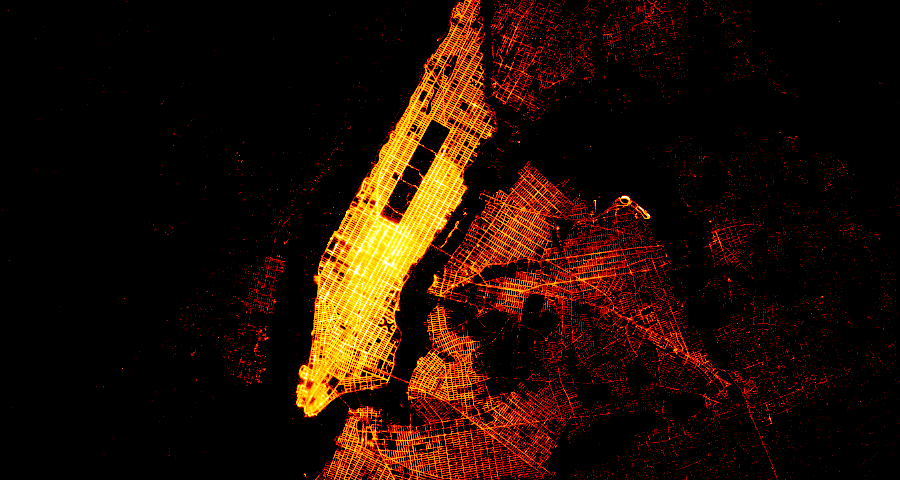

In [17]:
import datashader.transfer_functions as tf
tf.set_background(
    tf.shade(
        canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count()),
        cmap=cc.fire),
    'black')

And **Embeedding:**

As you can see, Datashader only renders the data, not any axes, colour bars, or similar features you’d expect in a complete plot.

To add features that help interpret data, we can embed the images generated by Datashader into a plot. The easiest way to do this is to use **HoloViews**, which is a high-level plotting API that allows you to use `Matplotlib`, `Bokeh`, or `Plotly` as the backend. 

An example of using **HoloViews** to define a "points" object and then datashade all the points is shown below. Alternatively, you can use the **rasterize** method instead of **datashade** to let `Bokeh` handle the transformation and colormapping steps, enabling hover and colorbars to function properly.

In [18]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(df, ['dropoff_x', 'dropoff_y'])
ropts = dict(tools=['hover'], colorbar=True, colorbar_position='bottom', cmap=cc.fire, cnorm='eq_hist')
taxi_trips = rasterize(points).opts(**ropts)
map_tiles * taxi_trips

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [dropoff_x,dropoff_y]   (Count)

## Why Datashader is so fast?

Datashader is able to perform quickly because it uses **GeoParquet files**. If your data is in the form of JSON or CSV files, this can be memory-intensive. The Parquet file format is ideal for columnar data such as dropoff points, as it is compact, loads quickly, efficiently reads only the necessary columns and ranges, and supports distributed and out-of-core operation when required. 

The second reason for this fast representation is the combined **projection and aggregation** step. This step requires calculating values for millions of data points, but all subsequent calculations use the final fixed-size grid and are therefore much faster.


# Challenge 4

1. You worked with two modern libraries to map big data. Can you describe the differences between working with Longboard and Datashader? Which one provides the most exciting functionality, and how do the outcomes from both of them vary?
2. Find a large dataset with at least 5 million records. Consider open datasets, government datasets, or any dataset of interest to you. Ensure the dataset is in a format that can be easily loaded into a Pandas DataFrame (Parquet file or another format).
3. Define a potential problem or scenario for mapping this dataset.
4. Load the dataset into a Pandas DataFrame and explore its structure. Here, **I advice you! to take a small portion of that rather than work with the entire table.**
5. Identify key variables of interest that could be effectively visualized using Datashader(https://datashader.org/index.html#). (e.g. is fine if the datasets have only locations, but we are aiming for at least one additional variable to represent in the map. 
6. Use the previous steps and the Datashader documentation to implement a `hvplot` Map.
7. Discuss/Write any challenges you have encountered related to the challenges and how you addressed them.
8. As always. Provide clear comments and/or citations in your code, explaining each step of the Datashader implementation (**Note: You don't need to run the Datashader pipeline**)
   
9. **For next week**, create a **four-slide presentation** summarizing the problem, data source, dataset, challenges, map, and insights from visualizing the large dataset. **Two slides for Challenge 2** and the **other two for this challenge**. You can also use the Notebooks as a tool to make your presentation. 

# Finishing the Lab

Please ensure that you save all your code and upload the latest version of this notebook to your **GitHub repository**. Add also a PDF file with the presentation related to the T9 of challenge 4., you should that in Moodle in General > Students Presentations Slides.

It is very impotant that when you are doing your commits, DO NOT INCLUDE large datasets, due to the size limits GitHub offers, if you are trying to push all the files on your repo including the data (large datasets) GitHub will give you an error. If you cant uplodad your large dataset, the question is: What can you do to create a fully reproducible code, that everyone can test and get the same results, if we are not allow to upload the large dataset, any suggestions?

> Always check the size of your notebook before making any commit; make good use of the `.gitignore` to skip big data sets or undesired files., you also need to curate your notebooks, levaing only the necesary outcomes cells, remove any installation cell, and think about your notebook as a tool that other people would read and try to understand what you have done.


# More resources

* [Stats Methods](http://www.statmethods.net/stats/descriptives.html) - some useful descriptions of various descriptive statistic methods / packages
* [Pandas cheat sheet](https://www.geeksforgeeks.org/pandas-cheat-sheet/) - lots of useful help and functions for working with spatial data
* [Urban Analytics Book](https://uk.sagepub.com/en-gb/eur/urban-analytics/book249267) - One of the most valuable and inital resources

Question 1: both londboard and datashader can be used to process large datasets without crashing your computer memory and taking up the ram.
Datashader appears to be more exciting as you can produce high quality visualisations of very large datasets quickly and without much code. It also appears that you can have more control over the output than lonboard.
lonboard is useful for creating basic visual displays of large datasets \

Accessibility of public transport is a key urban issue that all governments are facing. It is important for governments to assess the accessibility of their systems, and mapping these is a key way that this can happen. I have chosen a dataset of public transport in Germany to explore this, where variables including the walking distance of public transport stops have been mapped. 

The data is taken from: 
Maximilian T. Fischer, Daniel Fürst, Yannick Metz, Manuel Schmidt, Julius Rauscher, and Daniel A. Keim. OPTIMAP: A Dataset for Open Public Transport Infrastructure and Mobility Accessibility Profiles. Zenodo, 2025. doi: 10.5281/zenodo.14772646.

In [47]:
# read the parquet file

transport = pd.read_parquet("https://mobility.dbvis.de/data-results/OPTIMAP_v2025-02-01.parquet")

In [48]:
transport.head()

,lat,lng,MinDistanceWalking,scores_OVERALL
0,9.448092,54.790974,77,11.866496
1,9.449389,54.790550,165,11.389042
2,9.449661,54.790798,195,10.581425
3,9.459717,54.787842,343,12.936617
4,9.460062,54.787689,347,12.910222


In [49]:
# this is a very large dataset with over 34 million variables
transport.shape

(34627068, 4)

In [56]:
# explore a smaller portion of the data

first_1000_rows = transport.iloc[:1000]

print(first_1000_rows['MinDistanceWalking'].mean())
print(first_1000_rows['MinDistanceWalking'].std())

267.295
150.76737968731095


the minimum distance walking is a useful variable that could be used to understand the true accessibility of different public transport locations in Germany and allow their suitability to be assessed. 

In [59]:
# plot the dataset using hvplot

import hvplot.pandas

map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = transport.hvplot(
    'lat',
    'lng', 
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
)
map_tiles * plot

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [lat,lng]   (Count)

In [69]:
%%time
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(transport, ['lat', 'lng'])
pub_transport = datashade(points, cmap=cc.fire, width=900, height=480)
map_tiles * pub_transport

CPU times: user 8.63 ms, sys: 761 μs, total: 9.4 ms
Wall time: 8.86 ms


:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .RGB.I   :RGB   [lat,lng]   (R,G,B,A)

In [63]:
#Importing the required libraries.
import datashader as ds
import hvplot.pandas
import datashader.transfer_functions as tf
from holoviews.operation.datashader import rasterize

#define the datarange and project the number of pixels
canvas = ds.Canvas(plot_width=900, plot_height=480)

In [70]:
# transformation of the data

canvas.points(transport, 'lat', 'lng', agg=ds.count())


<xarray.DataArray (lng: 480, lat: 900)> Size: 2MB
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * lat      (lat) float64 7kB 5.872 5.882 5.892 5.902 ... 15.01 15.02 15.03
  * lng      (lng) float64 4kB 47.28 47.3 47.31 47.33 ... 55.0 55.01 55.03 55.04
Attributes:
    x_range:  (5.8667707443237305, 15.033259391784668)
    y_range:  (47.27375793457031, 55.05247497558594)

In [71]:
import numpy as np
np.power(canvas.points(transport, 'lat', 'lng', agg=ds.count()),2)

<xarray.DataArray (lng: 480, lat: 900)> Size: 2MB
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * lat      (lat) float64 7kB 5.872 5.882 5.892 5.902 ... 15.01 15.02 15.03
  * lng      (lng) float64 4kB 47.28 47.3 47.31 47.33 ... 55.0 55.01 55.03 55.04
Attributes:
    x_range:  (5.8667707443237305, 15.033259391784668)
    y_range:  (47.27375793457031, 55.05247497558594)

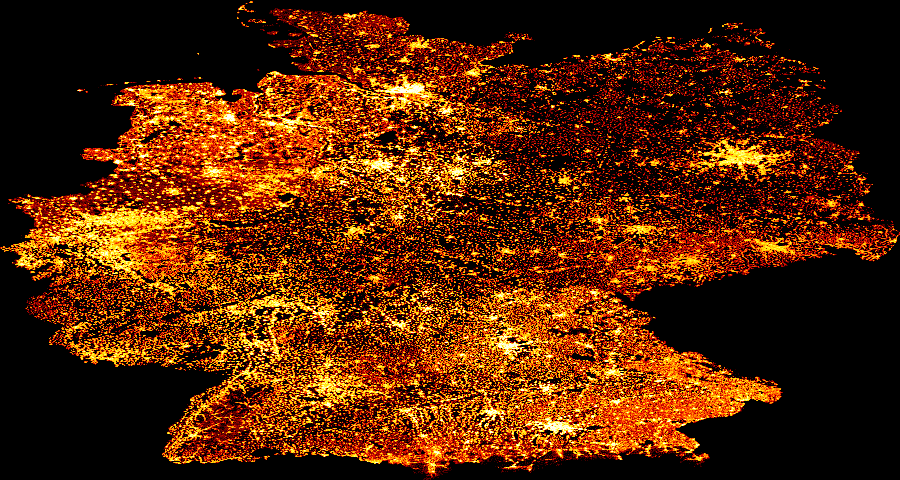

In [72]:
import datashader.transfer_functions as tf
tf.set_background(
    tf.shade(
        canvas.points(transport, 'lat', 'lng', agg=ds.count()),
        cmap=cc.fire),
    'black')

In [73]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(transport, ['lat', 'lng'])
ropts = dict(tools=['hover'], colorbar=True, colorbar_position='bottom', cmap=cc.fire, cnorm='eq_hist')
transport_datas = rasterize(points).opts(**ropts)
map_tiles * transport_datas

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [lat,lng]   (Count)

This shows that there is a far greater concentration of public transport availability in the South East of Germany as well as the North West. It is clear where cities are located as there is a far greater count some areas, and a network of transport points can be identified. The East of Germany has a low count of public transport availability, therefore attention could be turned to here to increase the connectivity of the country. In addition, by zooming in on specific cities and areas of interest, the places within cities that are the least serviced by public transport can be identified. Maps such as this are important for improving connectivity in cities, especially for initiatives such as improving air quality by reducing the number of cars on the road.

This map could be further improved by including a parameter for the minimum walking distance to the public transport location. This would allow the suitability to be better assessed. 

A challenge was encountered as the background ESRI map has not loaded. This is potentially due to the memory of the computer being exceeded.